## Problem Statement -
- Analyse customer-level data of a leading telecom firm, build predictive models to identify customers at high risk of churn and identify the main indicators of churn.

### Step 1 - Data understanding, preparation, and feature engineering

In [3]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

In [4]:
# Reading Data
df = pd.read_csv('telecom_churn_data.csv')
df.head()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,...,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
0,7000842753,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,197.385,...,0,1.0,1.0,1.0,NaN,968,30.4,0.0,101.20,3.58
1,7001865778,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,34.047,...,0,NaN,1.0,1.0,NaN,1006,0.0,0.0,0.00,0.00
2,7001625959,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,167.690,...,0,NaN,NaN,NaN,1.0,1103,0.0,0.0,4.17,0.00
3,7001204172,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,221.338,...,0,NaN,NaN,NaN,NaN,2491,0.0,0.0,0.00,0.00
4,7000142493,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,261.636,...,0,0.0,NaN,NaN,NaN,1526,0.0,0.0,0.00,0.00


In [5]:
df.shape

(99999, 226)

In [6]:
pd.set_option('display.max_columns', 300)
pd.set_option('display.max_rows', 30000)
df.head()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_t2c_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,og_others_6,og_others_7,og_others_8,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_t2o_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,date_of_last_rech_data_9,total_rech_data_6,total_rech_data_7,total_rech_data_8,total_rech_data_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,av_rech_amt_data_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
0,7000842753,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,197.385,214.816,213.803,21.100,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,0.00,0.00,0.00,0.00,NaN,NaN,0.16,NaN,NaN,NaN,4.13,NaN,NaN,NaN,1.15,NaN,NaN,NaN,5.44,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.00,NaN,0.00,0.00,5.44,0.00,NaN,NaN,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,NaN,4,3,

In [6]:
# feacture/column information
df.info(verbose=1)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Data columns (total 226 columns):
 #    Column                    Dtype  
---   ------                    -----  
 0    mobile_number             int64  
 1    circle_id                 int64  
 2    loc_og_t2o_mou            float64
 3    std_og_t2o_mou            float64
 4    loc_ic_t2o_mou            float64
 5    last_date_of_month_6      object 
 6    last_date_of_month_7      object 
 7    last_date_of_month_8      object 
 8    last_date_of_month_9      object 
 9    arpu_6                    float64
 10   arpu_7                    float64
 11   arpu_8                    float64
 12   arpu_9                    float64
 13   onnet_mou_6               float64
 14   onnet_mou_7               float64
 15   onnet_mou_8               float64
 16   onnet_mou_9               float64
 17   offnet_mou_6              float64
 18   offnet_mou_7              float64
 19   offnet_mou_8              float64
 20   offn

In [7]:
df.describe(include = 'all')

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_t2c_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,og_others_6,og_others_7,og_others_8,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_t2o_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,date_of_last_rech_data_9,total_rech_data_6,total_rech_data_7,total_rech_data_8,total_rech_data_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,av_rech_amt_data_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
count,9.999900e+04,99999.0,98981.0,98981.0,98981.0,99999,99398,98899,98340,99999.000000,99999.000000,99999.000000,99999.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000

### Filter high value customers as per below definition
Those who have recharged with an amount more than or equal to X, where X is the 70th percentile of the average recharge amount in the first two months (the good phase)

In [8]:
df['total_rech_amt_6_7_avg'] = (df['total_rech_amt_6'] + df['total_rech_amt_7'])/2

print("mean - ",df['total_rech_amt_6_7_avg'].mean())
print("median - ",df['total_rech_amt_6_7_avg'].median())
print("70th percentile - ",df['total_rech_amt_6_7_avg'].quantile(.7))


mean -  325.23879238792387
median -  229.0
70th percentile -  368.5


In [9]:
# Taking customers above 70th Percentile
df = df[df['total_rech_amt_6_7_avg'] >= df['total_rech_amt_6_7_avg'].quantile(.7)]
df.shape

(30011, 227)

In [10]:
# drop column 'total_rech_amt_6_7_avg'
df.drop('total_rech_amt_6_7_avg', axis=1, inplace=True)

#### Tag churners and remove attributes of the churn phase
Tag the churned customers (churn=1, else 0) based on the fourth month i.e. those who have not made any calls (either incoming or outgoing) and have not used mobile internet even once in the churn phase. The features we need to use to tag churners are:
- total_ic_mou_9
- total_og_mou_9
- vol_2g_mb_9
- vol_3g_mb_9

In [11]:
df['churn'] = np.where((df['total_ic_mou_9']==0) & (df['total_og_mou_9']==0) & (df['vol_2g_mb_9']==0) & (df['vol_3g_mb_9']==0), 1, 0)

In [12]:
df['churn'].value_counts(normalize=True)

0    0.913598
1    0.086402
Name: churn, dtype: float64

### We observe that 8.6% of customers have churned

In [13]:
# removing all feautres corresponding to the churn phase. 
col_delete = [col for col in df.columns.tolist() if '_9' in col]
df.drop(col_delete, axis=1, inplace=True)
df.shape

(30011, 173)

In [14]:
df.info(verbose=True, null_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30011 entries, 7 to 99997
Data columns (total 173 columns):
 #    Column                    Non-Null Count  Dtype  
---   ------                    --------------  -----  
 0    mobile_number             30011 non-null  int64  
 1    circle_id                 30011 non-null  int64  
 2    loc_og_t2o_mou            29897 non-null  float64
 3    std_og_t2o_mou            29897 non-null  float64
 4    loc_ic_t2o_mou            29897 non-null  float64
 5    last_date_of_month_6      30011 non-null  object 
 6    last_date_of_month_7      29980 non-null  object 
 7    last_date_of_month_8      29854 non-null  object 
 8    arpu_6                    30011 non-null  float64
 9    arpu_7                    30011 non-null  float64
 10   arpu_8                    30011 non-null  float64
 11   onnet_mou_6               29695 non-null  float64
 12   onnet_mou_7               29708 non-null  float64
 13   onnet_mou_8               29073 non-null  fl

In [15]:
# Checking Percentage of Null values 
percentage_null_value = (round(((df.isnull().sum()/len(df.index))*100),2).to_frame('null')).sort_values('null', ascending=False)
percentage_null_value

,null
count_rech_3g_6,62.02
av_rech_amt_data_6,62.02
max_rech_data_6,62.02
count_rech_2g_6,62.02
arpu_3g_6,62.02
date_of_last_rech_data_6,62.02
night_pck_user_6,62.02
total_rech_data_6,62.02
arpu_2g_6,62.02
fb_user_6,62.02


In [16]:
print("Total columns with null values -", len(percentage_null_value[percentage_null_value.null > 0].index))

print("Columns with null values > 50% -", len(percentage_null_value[percentage_null_value.null > 50].index))
print("Columns with null values > 60% -", len(percentage_null_value[percentage_null_value.null > 60].index))
print("Columns with null values > 70% -", len(percentage_null_value[percentage_null_value.null > 70].index))

Total columns with null values - 125
Columns with null values > 50% - 30
Columns with null values > 60% - 30
Columns with null values > 70% - 0


##### We observe that - there are total of 125 columns with null values out of which 30 columns have more that 60% missing data. Will drop columns with more than 60% of missing data and  try to impute missing data for the rest

In [17]:
# Drop 30 columns with missing data 
temp_col_list = list(percentage_null_value.index[percentage_null_value['null'] > 60])
df = df.drop(temp_col_list, axis=1)
df.shape

(30011, 143)

In [18]:
df.describe()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,churn
count,3.001100e+04,30011.0,29897.0,29897.0,29897.0,30011.000000,30011.000000,30011.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.0,29708.0,29073.0,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,30011.000000,30011.000000,30011.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.0,29708.0,29073.0,29695.000000,29708.000000,29073.000000,30011.000000,30011.000000,30011.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,29695.000000,29708.000000,29073.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000,30011.000000
mean,7.001223e+09,109.0,0.0,0.0,0.0,587.284404,589.135427,534.857433,299.184718,307.447285,276.234168,422.380819,428.248096,387.121245,17.598062,13.660030,13.683965,29.633675,22.260754,22.161948,95.688242,96.706103,89.951446,183.208674,183.120362,172.998297,7.053601,7.169655,6.703844,1.583837,

- Will drop column 'circle_id', since there is only one value for all the rows
- Also drop columns 
    loc_og_t2o_mou
    std_og_t2o_mou
    loc_ic_t2o_mou
    std_og_t2c_mou_6
    std_og_t2c_mou_7
    std_og_t2c_mou_8
    std_ic_t2o_mou_6
    std_ic_t2o_mou_7
    std_ic_t2o_mou_8
    since all of them have value as zero

In [19]:
df = df.drop(['circle_id', 'loc_og_t2o_mou','std_og_t2o_mou','loc_ic_t2o_mou','std_og_t2c_mou_6','std_og_t2c_mou_7','std_og_t2c_mou_8','std_ic_t2o_mou_6','std_ic_t2o_mou_7','std_ic_t2o_mou_8'], axis=1)
df.shape

(30011, 133)

In [20]:
# Dropping the date columns as they do not add any value here
date_col = [col for col in df.columns if 'date' in col]
df.drop(date_col, axis=1, inplace=True)
df.shape

(30011, 127)

In [21]:
# Checking null values percentage 
percentage_null_value = (round(((df.isnull().sum()/len(df.index))*100),2).to_frame('null')).sort_values('null', ascending=False)
percentage_null_value[percentage_null_value.null>0]

,null
loc_ic_t2f_mou_8,3.13
loc_ic_t2t_mou_8,3.13
loc_og_t2c_mou_8,3.13
loc_og_mou_8,3.13
std_og_t2t_mou_8,3.13
std_og_t2m_mou_8,3.13
std_og_t2f_mou_8,3.13
std_og_mou_8,3.13
isd_og_mou_8,3.13
spl_og_mou_8,3.13


In [22]:
# checking few columns for null values
df[df.loc_ic_t2f_mou_8.isnull()]

,mobile_number,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,churn
111,7001300706,596.301,146.073,0.000,55.19,3.26,NaN,45.51,12.34,NaN,0.00,0.00,NaN,0.00,0.00,NaN,55.19,3.26,NaN,43.83,12.34,NaN,0.00,0.00,NaN,0.00,0.00,NaN,99.03,15.61,NaN,0.00,0.00,NaN,0.00,0.00,NaN,1.30,0.00,NaN,1.30,0.00,NaN,0.00,0.00,NaN,0.38,2.71,NaN,1.29,0.00,NaN,102.01,18.33,0.0,50.01,16.66,NaN,160.68,58.53,NaN,5.06,0.40,NaN,215.76,75.59,NaN,0.00,0.00,NaN,0.00,0.00,NaN,1.13,0.00,NaN,1.13,0.00,NaN,217.04,75.59,0.0,0.00,0.00,NaN,0.00,0.00,NaN,0.15,0.00,NaN,12,8,5,704,178,0,154,50,0,154,30,0,284.50,0.00,0.00,0.00,0.00,0.00,1,0,0,0,0,0,0,0,0,1,0,0,332,0.00,0.00,0.00,0.00,1
143,7000106299,695.609,39.981,0.000,1325.91,28.61,NaN,13.91,1.89,NaN,0.00,8.94,NaN,0.00,8.53,NaN,18.89,6.83,NaN,8.58,1.56,NaN,0.00,0.00,NaN,2.09,0.00,NaN,27.48,8.39,NaN,1307.01,13.58,NaN,1.95,0.00,NaN,0.00,0.00,NaN,1308.96,13.58,NaN,0.00,0.00,NaN,3.38,0.00,NaN,1.20,0.00,NaN,1341.03,21.98,0.0,30.19,7.06,NaN,27.98,1.35,NaN,10.13,0.00,NaN,68.31,8.41,NaN,25.56,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,25.56,0.00,NaN,93.88,8.41,0.0,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,31,6,4,796,40,0,90,30,0,10,0,0,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0,0,0,0,0,0,0,0,0,0,264,0.00,0.00,0.00,0.00,1
188,7000340381,734.641,183.668,0.000,4.38,0.98,NaN,105.16,39.39,NaN,0.00,0.00,NaN,0.00,0.00,NaN,4.38,0.98,NaN,99.81,38.98,NaN,5.34,0.41,NaN,0.00,0.00,NaN,109.54,40.38,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,109.54,40.38,0.0,21.18,13.44,NaN,217.03,56.63,NaN,18.28,2.94,NaN,256.49,73.03,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,256.49,73.03,0.0,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,6,1,0,864,120,0,252,120,0,252,120,0,58.44,0.00,0.00,1522.40,0.00,0.00,0,0,0,0,0,0,2,0,0,0,0,0,244,0.00,831.48,1223.04,0.00,1
358,7002255278,688.670,205.780,707.910,68.34,38.93,NaN,550.18,209.68,NaN,19.39,0.00,NaN,61.93,0.00,NaN,35.88,17.31,NaN,98.11,159.08,NaN,58.99,9.66,NaN,0.00,0.00,NaN,192.99,186.06,NaN,32.46,21.61,NaN,318.89,40.93,NaN,11.58,0.00,NaN,362.94,62.54,NaN,0.00,0.00,NaN,0.65,0.00,NaN,0.00,0.00,NaN,556.59,248.61,0.0,15.61,5.58,NaN,28.86,15.49,NaN,24.63,0.00,NaN,69.11,21.08,NaN,3.36,13.36,NaN,87.84,0.00,NaN,0.00,0.00,NaN,91.21,13.36,NaN,171.09

In [22]:
# checking few columns for null values
df[df.loc_og_t2c_mou_8.isnull()]

,mobile_number,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,churn
111,7001300706,596.301,146.073,0.000,55.19,3.26,NaN,45.51,12.34,NaN,0.00,0.00,NaN,0.00,0.00,NaN,55.19,3.26,NaN,43.83,12.34,NaN,0.00,0.00,NaN,0.00,0.00,NaN,99.03,15.61,NaN,0.00,0.00,NaN,0.00,0.00,NaN,1.30,0.00,NaN,1.30,0.00,NaN,0.00,0.00,NaN,0.38,2.71,NaN,1.29,0.00,NaN,102.01,18.33,0.0,50.01,16.66,NaN,160.68,58.53,NaN,5.06,0.40,NaN,215.76,75.59,NaN,0.00,0.00,NaN,0.00,0.00,NaN,1.13,0.00,NaN,1.13,0.00,NaN,217.04,75.59,0.0,0.00,0.00,NaN,0.00,0.00,NaN,0.15,0.00,NaN,12,8,5,704,178,0,154,50,0,154,30,0,284.50,0.00,0.00,0.00,0.00,0.00,1,0,0,0,0,0,0,0,0,1,0,0,332,0.00,0.00,0.00,0.00,1
143,7000106299,695.609,39.981,0.000,1325.91,28.61,NaN,13.91,1.89,NaN,0.00,8.94,NaN,0.00,8.53,NaN,18.89,6.83,NaN,8.58,1.56,NaN,0.00,0.00,NaN,2.09,0.00,NaN,27.48,8.39,NaN,1307.01,13.58,NaN,1.95,0.00,NaN,0.00,0.00,NaN,1308.96,13.58,NaN,0.00,0.00,NaN,3.38,0.00,NaN,1.20,0.00,NaN,1341.03,21.98,0.0,30.19,7.06,NaN,27.98,1.35,NaN,10.13,0.00,NaN,68.31,8.41,NaN,25.56,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,25.56,0.00,NaN,93.88,8.41,0.0,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,31,6,4,796,40,0,90,30,0,10,0,0,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0,0,0,0,0,0,0,0,0,0,264,0.00,0.00,0.00,0.00,1
188,7000340381,734.641,183.668,0.000,4.38,0.98,NaN,105.16,39.39,NaN,0.00,0.00,NaN,0.00,0.00,NaN,4.38,0.98,NaN,99.81,38.98,NaN,5.34,0.41,NaN,0.00,0.00,NaN,109.54,40.38,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,109.54,40.38,0.0,21.18,13.44,NaN,217.03,56.63,NaN,18.28,2.94,NaN,256.49,73.03,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,256.49,73.03,0.0,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,6,1,0,864,120,0,252,120,0,252,120,0,58.44,0.00,0.00,1522.40,0.00,0.00,0,0,0,0,0,0,2,0,0,0,0,0,244,0.00,831.48,1223.04,0.00,1
358,7002255278,688.670,205.780,707.910,68.34,38.93,NaN,550.18,209.68,NaN,19.39,0.00,NaN,61.93,0.00,NaN,35.88,17.31,NaN,98.11,159.08,NaN,58.99,9.66,NaN,0.00,0.00,NaN,192.99,186.06,NaN,32.46,21.61,NaN,318.89,40.93,NaN,11.58,0.00,NaN,362.94,62.54,NaN,0.00,0.00,NaN,0.65,0.00,NaN,0.00,0.00,NaN,556.59,248.61,0.0,15.61,5.58,NaN,28.86,15.49,NaN,24.63,0.00,NaN,69.11,21.08,NaN,3.36,13.36,NaN,87.84,0.00,NaN,0.00,0.00,NaN,91.21,13.36,NaN,171.09

In [23]:
df[df.loc_og_t2c_mou_8.isnull() & df.loc_og_mou_8.isnull() & df.loc_ic_t2f_mou_8.isnull()]

,mobile_number,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,churn
111,7001300706,596.301,146.073,0.000,55.19,3.26,NaN,45.51,12.34,NaN,0.00,0.00,NaN,0.00,0.00,NaN,55.19,3.26,NaN,43.83,12.34,NaN,0.00,0.00,NaN,0.00,0.00,NaN,99.03,15.61,NaN,0.00,0.00,NaN,0.00,0.00,NaN,1.30,0.00,NaN,1.30,0.00,NaN,0.00,0.00,NaN,0.38,2.71,NaN,1.29,0.00,NaN,102.01,18.33,0.0,50.01,16.66,NaN,160.68,58.53,NaN,5.06,0.40,NaN,215.76,75.59,NaN,0.00,0.00,NaN,0.00,0.00,NaN,1.13,0.00,NaN,1.13,0.00,NaN,217.04,75.59,0.0,0.00,0.00,NaN,0.00,0.00,NaN,0.15,0.00,NaN,12,8,5,704,178,0,154,50,0,154,30,0,284.50,0.00,0.00,0.00,0.00,0.00,1,0,0,0,0,0,0,0,0,1,0,0,332,0.00,0.00,0.00,0.00,1
143,7000106299,695.609,39.981,0.000,1325.91,28.61,NaN,13.91,1.89,NaN,0.00,8.94,NaN,0.00,8.53,NaN,18.89,6.83,NaN,8.58,1.56,NaN,0.00,0.00,NaN,2.09,0.00,NaN,27.48,8.39,NaN,1307.01,13.58,NaN,1.95,0.00,NaN,0.00,0.00,NaN,1308.96,13.58,NaN,0.00,0.00,NaN,3.38,0.00,NaN,1.20,0.00,NaN,1341.03,21.98,0.0,30.19,7.06,NaN,27.98,1.35,NaN,10.13,0.00,NaN,68.31,8.41,NaN,25.56,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,25.56,0.00,NaN,93.88,8.41,0.0,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,31,6,4,796,40,0,90,30,0,10,0,0,0.00,0.00,0.00,0.00,0.00,0.00,0,0,0,0,0,0,0,0,0,0,0,0,264,0.00,0.00,0.00,0.00,1
188,7000340381,734.641,183.668,0.000,4.38,0.98,NaN,105.16,39.39,NaN,0.00,0.00,NaN,0.00,0.00,NaN,4.38,0.98,NaN,99.81,38.98,NaN,5.34,0.41,NaN,0.00,0.00,NaN,109.54,40.38,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,109.54,40.38,0.0,21.18,13.44,NaN,217.03,56.63,NaN,18.28,2.94,NaN,256.49,73.03,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,256.49,73.03,0.0,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,6,1,0,864,120,0,252,120,0,252,120,0,58.44,0.00,0.00,1522.40,0.00,0.00,0,0,0,0,0,0,2,0,0,0,0,0,244,0.00,831.48,1223.04,0.00,1
358,7002255278,688.670,205.780,707.910,68.34,38.93,NaN,550.18,209.68,NaN,19.39,0.00,NaN,61.93,0.00,NaN,35.88,17.31,NaN,98.11,159.08,NaN,58.99,9.66,NaN,0.00,0.00,NaN,192.99,186.06,NaN,32.46,21.61,NaN,318.89,40.93,NaN,11.58,0.00,NaN,362.94,62.54,NaN,0.00,0.00,NaN,0.65,0.00,NaN,0.00,0.00,NaN,556.59,248.61,0.0,15.61,5.58,NaN,28.86,15.49,NaN,24.63,0.00,NaN,69.11,21.08,NaN,3.36,13.36,NaN,87.84,0.00,NaN,0.00,0.00,NaN,91.21,13.36,NaN,171.09

#### It looks like there are rows where multiple columns as null. Will drop these rows from dataset

In [24]:
df = df[~(df.loc_og_t2c_mou_8.isnull() & df.loc_og_mou_8.isnull() & df.loc_ic_t2f_mou_8.isnull())]
df.shape

(29073, 127)

In [25]:
# checking again for null values 
percentage_null_value = (round(((df.isnull().sum()/len(df.index))*100),2).to_frame('null')).sort_values('null', ascending=False)
percentage_null_value[percentage_null_value.null>0]

,null
loc_og_t2m_mou_6,0.58
loc_og_t2t_mou_6,0.58
std_ic_mou_6,0.58
std_og_t2m_mou_6,0.58
loc_ic_mou_6,0.58
std_og_t2t_mou_6,0.58
isd_og_mou_6,0.58
loc_og_mou_6,0.58
std_ic_t2f_mou_6,0.58
spl_og_mou_6,0.58


In [26]:
# Checking on other columns 
df[df.spl_og_mou_6.isnull() & df.roam_og_mou_6.isnull() & df.std_ic_t2t_mou_6.isnull() & df.std_ic_t2m_mou_6.isnull()]

,mobile_number,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,churn
77,7001328263,30.000,82.378,674.950,NaN,34.23,149.69,NaN,39.44,179.18,NaN,0.00,0.00,NaN,0.00,0.00,NaN,34.23,149.69,NaN,32.18,101.63,NaN,0.91,29.86,NaN,0.00,3.90,NaN,67.33,281.19,NaN,0.00,0.00,NaN,0.00,0.00,NaN,6.35,40.09,NaN,6.35,40.09,NaN,2.93,28.04,NaN,0.00,7.58,NaN,0.0,0.00,0.0,76.61,356.93,NaN,79.46,191.24,NaN,43.31,94.18,NaN,2.03,0.00,NaN,124.81,285.43,NaN,8.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,8.00,0.00,0.0,135.38,289.33,NaN,0.00,0.00,NaN,2.56,0.50,NaN,0.00,3.39,4,5,3,0,1154,750,0,1000,750,0,0,750,0.00,96.48,0.00,0.00,0.00,0.00,0,1,0,0,0,0,0,0,0,0,0,0,1894,0.00,0.00,0.00,0.00,0
364,7002168045,0.000,792.112,989.368,NaN,433.49,198.96,NaN,845.11,923.58,NaN,0.00,0.00,NaN,0.00,0.00,NaN,28.78,7.46,NaN,78.78,584.76,NaN,21.58,9.43,NaN,0.00,0.00,NaN,129.14,601.66,NaN,404.71,191.49,NaN,722.01,321.41,NaN,0.00,0.00,NaN,1126.73,512.91,NaN,0.00,0.00,NaN,45.14,13.84,NaN,0.0,0.00,0.0,1301.03,1128.43,NaN,7.41,10.23,NaN,69.39,93.48,NaN,0.00,0.83,NaN,76.81,104.54,NaN,5.81,10.09,NaN,37.94,86.63,NaN,0.00,0.00,NaN,43.76,96.73,0.0,185.14,219.59,NaN,0.00,0.00,NaN,64.56,18.31,NaN,0.00,0.00,4,12,24,0,970,1104,0,154,154,0,50,50,0.00,565.78,2108.66,0.00,0.00,0.00,0,1,1,0,0,2,0,0,0,0,0,1,424,0.00,0.00,0.00,0.00,0
423,7000635248,213.802,304.194,149.710,NaN,0.00,0.00,NaN,10.03,1.45,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.58,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.58,NaN,0.00,0.00,NaN,0.00,0.25,NaN,0.00,0.61,NaN,0.00,0.86,NaN,10.03,0.00,NaN,0.00,0.00,NaN,0.0,0.00,0.0,10.03,1.45,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.36,NaN,0.00,0.36,0.0,8.31,0.36,NaN,0.00,0.00,NaN,8.31,0.00,NaN,0.00,0.00,4,4,3,252,591,0,252,339,0,252,0,0,3.30,38.45,0.00,669.36,837.18,0.00,0,0,0,0,0,0,1,1,0,0,0,0,945,73.55,266.94,63.04,0.00,0
934,7002152278,48.000,764.152,500.030,NaN,14.24,17.48,NaN,16.99,76.86,NaN,0.00,8.81,NaN,0.00,1.56,NaN,0.08,17.48,NaN,16.99,63.23,NaN,0.00,12.08,NaN,0.00,0.00,NaN,17.08,92.79,NaN,14.16,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,14.16,0.00,NaN,20.13,8.41,NaN,0.00,0.00,NaN,0.0,0.00,0.0,51.38,101.21,NaN,0.39,20.09,NaN,4.53,51.16,NaN,7.80,17.08,NaN,12.73,88.34,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.00,NaN,0.00,0.

In [27]:
# dropping these columns as well
df = df[~(df.spl_og_mou_6.isnull() & df.roam_og_mou_6.isnull() & df.std_ic_t2t_mou_6.isnull() & df.std_ic_t2m_mou_6.isnull())]
df.shape

(28904, 127)

In [28]:
# # Checking remaining columns for null values
percentage_null_value = (round(((df.isnull().sum()/len(df.index))*100),2).to_frame('null')).sort_values('null', ascending=False)
percentage_null_value[percentage_null_value.null>0]

,null
std_ic_t2f_mou_7,0.15
loc_og_mou_7,0.15
loc_og_t2m_mou_7,0.15
isd_og_mou_7,0.15
loc_og_t2f_mou_7,0.15
isd_ic_mou_7,0.15
loc_og_t2c_mou_7,0.15
loc_ic_t2t_mou_7,0.15
ic_others_7,0.15
loc_og_t2t_mou_7,0.15


In [29]:
df = df[~(df.std_og_t2m_mou_7.isnull() & df.std_og_mou_7.isnull() & df.std_ic_t2f_mou_7.isnull())]
df.shape

(28861, 127)

In [30]:
# checking again for null values 
percentage_null_value = (round(((df.isnull().sum()/len(df.index))*100),2).to_frame('null')).sort_values('null', ascending=False)
percentage_null_value[percentage_null_value.null>0]

,null


#### No more null values in the dataset

### Check and fix outliers

In [31]:
df.describe(percentiles=[.25,.5,.75,.90,.95,.99])

,mobile_number,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,churn
count,2.886100e+04,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.00000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.00000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.00000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000,28861.000000
mean,7.001229e+09,583.567951,594.558340,548.296744,296.272163,309.163947,275.867752,418.632928,431.588700,386.862307,17.350686,13.622360,13.641925,29.124845,22.141013,22.149123,96.345587,98.439796,90.381558,183.901342,185.87273,173.683376,7.124348,7.271403,6.707281,1.579216,1.878539,1.765744,287.38021,291.593068,270.780934,188.470207,201.959683,176.959112,201.182936,216.136208,184.471419,2.034966,2.073900,1.849584,391.692477,420.174180,363.284144,2.067312,2.142616,2.034974,5.926283,7.534818,7.103449,0.687966,0.048995,0.061485,68

Will use average arpu to remove outliers. Will drop those records wherever average arpu of month 6,7 and 8 is significantly high.

In [32]:
df['avg_arpu_6_7_8'] = (df.arpu_6 + df.arpu_7 + df.arpu_8)/3


In [33]:
# drop rows with average arpu > 99 percentile
df = df[~(df.avg_arpu_6_7_8 > df.avg_arpu_6_7_8.quantile(.99))]

In [34]:
# drop column 'avg_arpu_6_7_8'
df.drop('avg_arpu_6_7_8', axis=1, inplace=True)

In [35]:
df.describe(percentiles=[.25,.5,.75,.90,.95,.99])

,mobile_number,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,churn
count,2.857200e+04,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000,28572.000000
mean,7.001228e+09,563.269608,572.370073,526.224245,291.641679,304.607052,270.688728,410.211082,423.144469,378.174485,16.824186,13.093188,13.071936,27.611174,20.663598,20.598338,95.441206,97.620094,89.151090,181.130195,183.551111,171.314406,6.961765,7.101731,6.598127,1.574907,1.873758,1.761838,283.542093,288.282070,267.072336,185.255004,198.717823,173.596146,197.558097,212.080908,180.033005,1.989654,2.019977,1.827971,384.807113,412.823083,355.461137,1.224838,1.205092,1.133992,5.845975,7.438178,7.060640,0.686163,0.036506,0.0494

### EDA: Univariate, Bivariate and Correlation Analysis

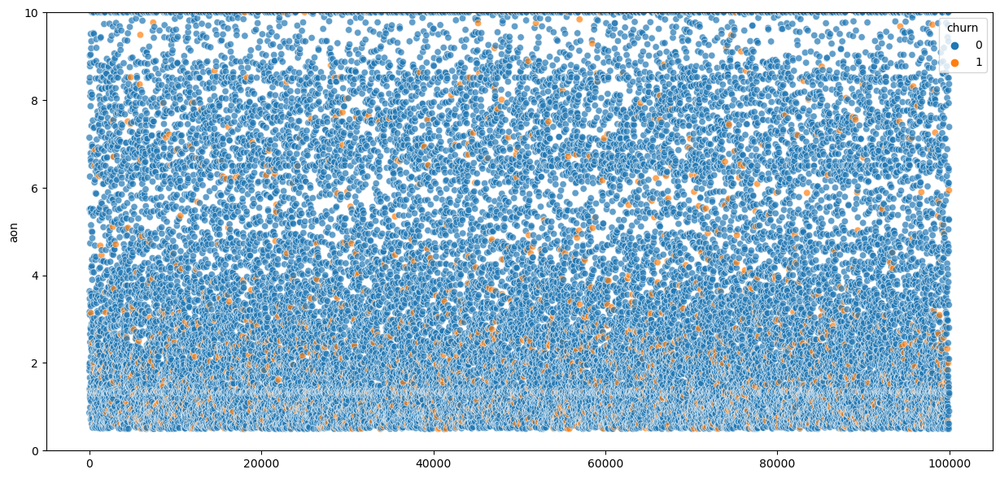

In [36]:
# Checking the churn based on tenure

plt.figure(figsize=(15,7))
sns.scatterplot(y=df['aon'] / 365, x=df.index, hue=df.churn, alpha=0.7)
plt.ylim(0,10)
plt.show()

We observe majority of customers churn occur in 0-4 years

<AxesSubplot:ylabel='Frequency'>

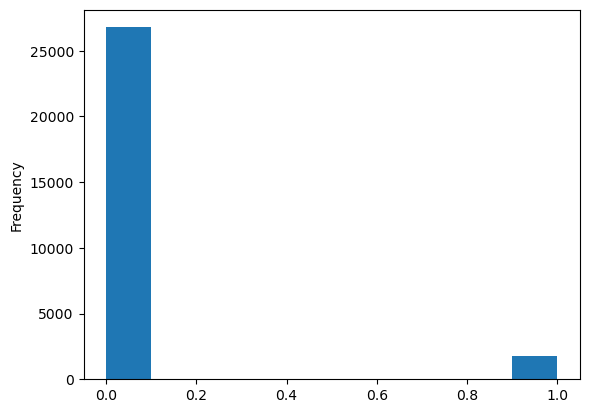

In [37]:
# Checking the spread of Churn across the customer base
df.churn.plot.hist()

We observe data is heavily imbalanced (>90%) towards customers who are not likely to churn

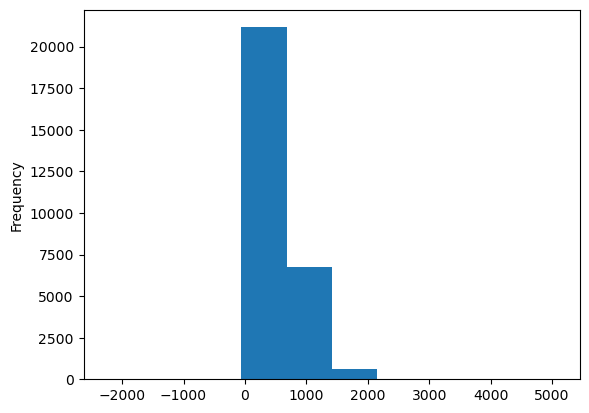

In [38]:
# Checking the arpu for June to visualize the spread of customers
df.arpu_6.plot.hist()
plt.show()

Majority of customers were attributing to 0 arpu in the month of June. Approx 20000+

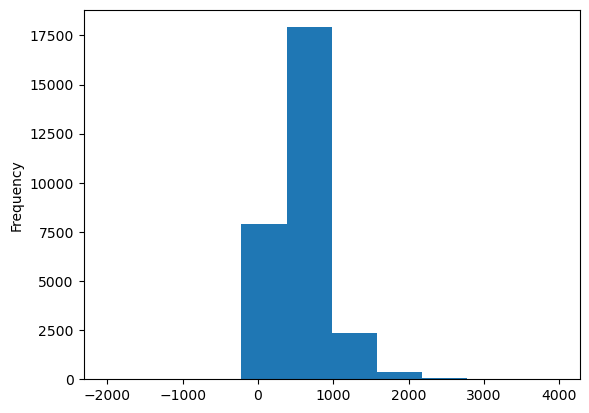

In [39]:
# Check the arpu for July to visualize the spread of customers
df.arpu_7.plot.hist()
plt.show()

Customers with 0 arpu have significantly reduced from June, now only 7500 customers attribute to 0 arpu

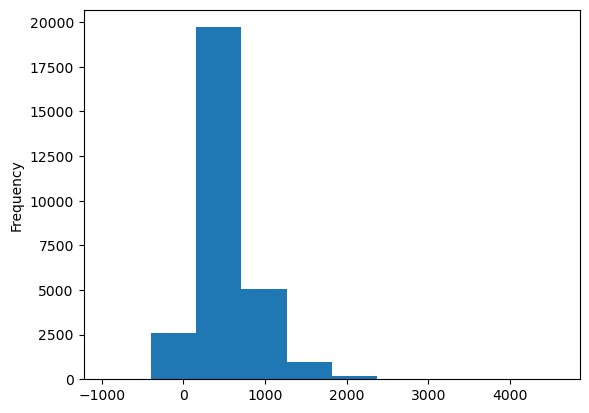

In [40]:
# Check the arpu for August to visualize the spread of customers
df.arpu_8.plot.hist()
plt.show()

August is even better than July, now only ~2500 customers are attributed towards 0 arpu

In [41]:
corrdata = df.corr()

<AxesSubplot:>

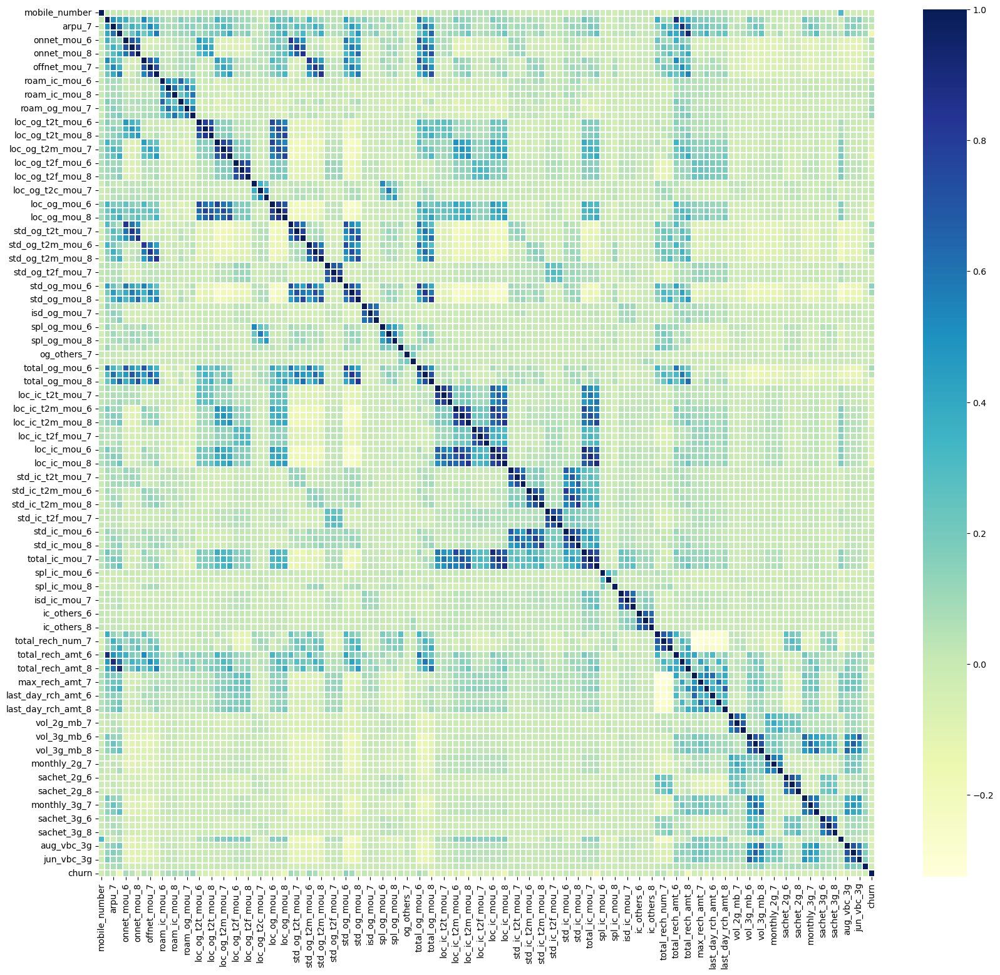

In [42]:
f, ax = plt.subplots(figsize =(20, 18))
sns.heatmap(corrdata, ax = ax, cmap ="YlGnBu", linewidths = 0.1)

We observe total_rech_num_7 shows max corelation, std_og_mou_6, total_og_mou_6 and few more have higher correlation with Churn
onnet_mou_9. offnet_mou_7 and others have negative correlation with churn

### Modeling. 
- Since number of independent variables is high, we will use PCA to derive the model.

#### Train - Test Split

In [43]:
# Import library
from sklearn.model_selection import train_test_split
# Putting feature variables into X
X = df.drop(['mobile_number','churn'], axis=1)
# Putting target variable to y
y = df['churn']
# Splitting data into train and test set 70:30
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.7, test_size=0.3, stratify = y, random_state=42)


In [44]:
df.churn.value_counts(normalize=True)

0    0.937526
1    0.062474
Name: churn, dtype: float64

In [45]:
y_train.value_counts(normalize=True)

0    0.93755
1    0.06245
Name: churn, dtype: float64

In [46]:
y_test.value_counts(normalize=True)

0    0.937471
1    0.062529
Name: churn, dtype: float64

### Churn data is only 6.2 percent.

### Feature scaling - using standard scaler

In [47]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train[X_train.columns] = scaler.fit_transform(X_train[X_train.columns])
X_train.head()

,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
30607,-0.772208,-0.774241,-0.882046,-0.078037,-0.210230,-0.122590,-0.559940,-0.392089,-0.339058,-0.220105,-0.187544,-0.143575,-0.255931,-0.229913,-0.222058,0.037001,0.022874,-0.181279,-0.441139,-0.087327,0.071126,-0.335587,-0.334867,-0.330044,-0.216572,-0.190713,-0.238372,-0.287595,-0.058808,-0.089127,-0.081210,-0.235024,-0.011740,-0.273336,-0.315632,-0.360614,-0.169966,-0.157948,-0.158923,-0.244278,-0.378992,-0.250880,-0.096992,-0.104903,-0.085956,-0.028550,-0.317837,-0.297901,-0.303087,-0.025182,-0.026115,-0.402257,-0.400123,-0.289597,0.074237,0.005679,-0.144520,-0.479405,0.045381,-0.045969,-0.344881,-0.334126,-0.259183,-0.344252,-0.019402,-0.144147,0.420299,-0.143211,-0.048209,0.022473,-0.122242,-0.231843,-0.13222,-0.140783,-0.136837,0.241776,-0.187296,-0.216768,-0.226157,-0.131804,-0.245414,2.172594,-0.100024,-0.253273,-0.172952,-0.171551,-0.17047,-0.005477,-0.089017,-0.091842,0.208822,-0.105037,0.489869,-0.673566,-0.861649,-0.860073,-0.615360,-0.658833,-0.722345,-0.434609,-0.290439,-0.715064,-0.280102,-0.276665,-0.253078,-0.320452,-0.345359,-0.332419,-0.340067,-0.345745,-0.324387,-0.292945,-0.309458,2.324480,-0.302104,-0.307846,-0.303721,-0.158532,-0.158567,-0.148123,-1.025670,-0.336561,-0.337792,-0.312986,-0.133717
12460,-0.004589,0.320969,1.047548,0.633898,1.888198,2.065372,0.599617,-0.150890,0.330899,-0.220105,-0.187544,-0.184609,-0.255931,-0.229913,-0.222058,-0.331244,-0.235785,-0.232956,-0.519076,-0.566677,-0.345817,-0.335587,-0.334867,-0.330044,-0.046616,-0.149141,0.178274,-0.571005,-0.537155,-0.391082,0.940741,2.336467,2.510345,1.080713,0.223451,0.642492,-0.169966,-0.157948,-0.158923,1.372796,1.712701,2.124505,-0.096992,-0.104903,-0.085956,-0.107553,-0.182085,0.216577,0.264502,-0.025182,-0.026115,0.924090,1.275950,1.703363,-0.356726,-0.285326,-0.222439,-0.548290,-0.623386,-0.429320,-0.276873,-0.339154,-0.351251,-0.610449,-0.635161,-0.465404,0.060047,-0.033490,0.275013,-0.128560,-0.048666,0.019908,-0.13222,-0.140783,-0.136837,-0.074218,-0.072802,0.133706,-0.588909,-0.606717,-0.379480,-0.416176,-0.100024,-0.253273,-0.172952,-0.171551,-0.17047,-0.076169,-0.089017,-0.091842,-0.426282,-0.314087,0.170121,-0.117047,0.461500,1.026082,0.379016,0.372084,-0.115962,-0.4

In [48]:
X_test[X_train.columns] = scaler.transform(X_test[X_train.columns])
X_test.head()

,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
68391,0.445223,-0.403258,0.955462,-0.651090,-0.637415,-0.546369,-0.340606,-0.751056,-0.375512,-0.220105,-0.187544,-0.184609,-0.255931,-0.229913,-0.222058,-0.382516,-0.364585,-0.269503,-0.478144,-0.646646,0.090972,1.723564,-0.201702,0.221471,0.836062,-0.190713,-0.238372,-0.459474,-0.667362,-0.102225,-0.479653,-0.479757,-0.442172,-0.199923,-0.507068,-0.458172,2.209727,3.150963,-0.076889,-0.419569,-0.607417,-0.605729,-0.096992,0.276504,0.106492,0.097965,-0.348369,-0.210073,-0.303087,-0.025182,-0.026115,-0.663660,-0.961881,-0.609615,-0.389982,-0.387236,-0.393988,-0.278762,-0.379940,-0.131487,0.295709,0.122203,-0.316321,-0.355796,-0.450980,-0.342073,-0.108654,-0.194137,0.153227,1.150323,-0.179895,-0.000692,0.184142,-0.128692,-0.084336,0.763254,-0.255285,0.064603,0.018546,-0.451276,-0.085460,1.541187,-0.100024,-0.253273,0.100998,0.237982,1.003868,-0.076169,-0.067060,-0.084504,0.102972,-0.627662,-0.469373,0.724263,-0.083326,0.565591,-0.081343,-0.105192,-0.051453,0.398600,0.373567,0.255917,-0.182332,0.002083,0.089831,1.365192,1.536710,1.707539,4.961056,2.195566,5.178357,-0.292945,-0.309458,-0.335047,-0.302104,-0.307846,-0.303721,-0.158532,-0.158567,-0.148123,-0.326296,3.559407,2.781311,2.767551,-0.133717
11549,-0.347296,-0.187003,0.092491,-0.475542,-0.299365,-0.334198,-0.752022,-0.699370,-0.673923,-0.220105,0.021668,0.340915,-0.255931,-0.049354,0.003995,-0.046207,0.217369,0.035273,-0.425014,-0.468681,-0.452398,-0.196573,0.131444,-0.273696,-0.216572,-0.190713,-0.238372,-0.321407,-0.141855,-0.284207,-0.479653,-0.467247,-0.420030,-0.509710,-0.493088,-0.452458,-0.142378,-0.157948,-0.010179,-0.676486,-0.657104,-0.585631,-0.096992,-0.104903,-0.085956,-0.326330,-0.348369,-0.297901,-0.303087,-0.025182,-0.026115,-0.831298,-0.708862,-0.701243,0.136669,0.058225,0.218497,-0.375107,-0.302566,-0.285006,0.039693,0.308636,-0.089158,-0.181393,-0.125149,-0.097574,-0.196615,-0.073511,-0.120021,-0.312156,-0.210369,-0.258939,0.063166,-0.038939,-0.136837,-0.322435,-0.195272,-0.272958,-0.279479,-0.219702,-0.105542,-0.416176,-0.100024,-0.253273,0.072469,-0.142426,0.495939,-0.076169,-0.089017,-0.091842,-0.849684,-0.941237,-0.682538,-1.088996,-0.192291,-0.006535,0.520192,1.142090,1.212920,-0.767893,-0.8

In [49]:
# Creating X_train_feature and X_test_feature
X_train_feature = X_train
X_test_feature = X_test

### Apply PCA to reduce number of features

In [50]:
#Import PCA
from sklearn.decomposition import PCA
pca = PCA(random_state=42)

pca.fit(X_train)
pca.components_

array([[ 1.11348544e-01,  1.22056020e-01,  1.29377898e-01, ...,
         4.20263784e-02,  3.77805930e-02,  1.47307089e-02],
       [ 1.18656018e-01,  1.58708828e-01,  1.37104766e-01, ...,
        -6.72799536e-02, -6.62900292e-02, -1.35462387e-02],
       [ 1.05495675e-01,  1.47572902e-01,  1.46615599e-01, ...,
         2.36989170e-01,  2.23469434e-01,  7.08144228e-02],
       ...,
       [-6.96522229e-08,  1.82429466e-07,  6.97838310e-08, ...,
         1.68983490e-08,  4.47705828e-08,  5.46911364e-08],
       [-3.38448714e-08,  7.51617920e-08,  5.49963727e-08, ...,
        -3.00579100e-08, -6.33702054e-08,  5.36678902e-08],
       [-1.68214020e-07,  2.05310623e-07, -1.87406031e-07, ...,
         4.14214494e-08, -8.65970518e-09, -3.61976945e-08]])

Text(0, 0.5, 'Cumulative Variance')

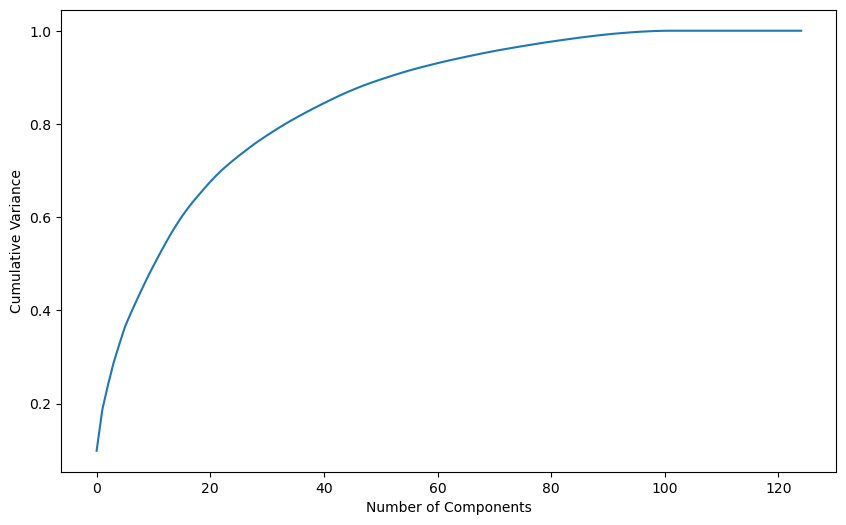

In [51]:
# Finding number of pca variables that explains most of the data. plot feature variance.
cum_variance = np.cumsum(pca.explained_variance_ratio_)

fig = plt.figure(figsize = (10,6))
plt.plot(cum_variance)
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Variance')

### We observe around 80 components explain most of the data. Hence will go with 80 components for the model

In [52]:
# Applying PCA with 80 components on train and test data
from sklearn.decomposition import IncrementalPCA
pca_final = IncrementalPCA(n_components=80)
X_train_pca = pca_final.fit_transform(X_train)
X_test_pca = pca_final.transform(X_test)

### Logistic Regression with PCA and hyperparameter tuning

In [53]:
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV

In [54]:
# using 5 folds and scoring parameter as 'recall'
folds = KFold(n_splits=5, shuffle=True, random_state=4)
params = {"C": [0.01, 0.1, 1, 10, 100, 1000]}

model_cv = GridSearchCV(estimator = LogisticRegression(class_weight="balanced"),
                        param_grid = params, 
                        scoring= 'recall', 
                        cv = folds, 
                        verbose = 1,
                        return_train_score=True) 

# Fit the model
model_cv.fit(X_train_pca, y_train)
cv_results = pd.DataFrame(model_cv.cv_results_)

Fitting 5 folds for each of 6 candidates, totalling 30 fits


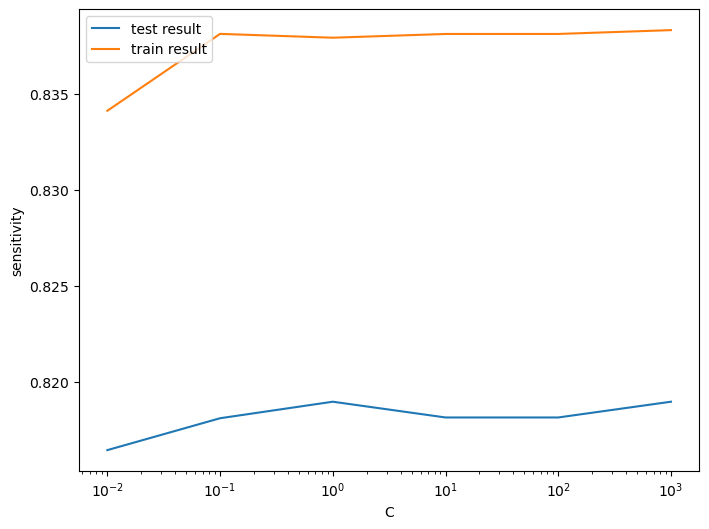

In [55]:
# plot of C versus train and validation scores

plt.figure(figsize=(8, 6))
plt.plot(cv_results['param_C'], cv_results['mean_test_score'])
plt.plot(cv_results['param_C'], cv_results['mean_train_score'])
plt.xlabel('C')
plt.ylabel('sensitivity')
plt.legend(['test result', 'train result'], loc='upper left')
plt.xscale('log')

In [56]:
best_score = model_cv.best_score_
best_C = model_cv.best_params_['C']

print(" The highest test sensitivity is {0} at C = {1}".format(best_score, best_C))

 The highest test sensitivity is 0.8189684515561936 at C = 1


In [57]:
# Logistic regression with optimal C
logistic_pca = LogisticRegression(C=best_C, class_weight="balanced")
log_pca_model = logistic_pca.fit(X_train_pca, y_train)

#### Validating the model

In [58]:
y_train_pred = log_pca_model.predict(X_train_pca)
confusion = metrics.confusion_matrix(y_train, y_train_pred)
print(confusion)


[[14809  3942]
 [  204  1045]]


In [59]:
TP = confusion[1,1] # true positive 
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives

# Accuracy
print("Accuracy:-",metrics.accuracy_score(y_train, y_train_pred))

# Sensitivity
print("Sensitivity:-",TP / float(TP+FN))

# Specificity
print("Specificity:-", TN / float(TN+FP))

Accuracy:- 0.7927
Sensitivity:- 0.8366693354683747
Specificity:- 0.7897712122020158


In [60]:
# Checking model on Test set
y_test_pred = log_pca_model.predict(X_test_pca)
confusion = metrics.confusion_matrix(y_test, y_test_pred)
TP = confusion[1,1] # true positive 
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives

# Accuracy
print("Accuracy:-",metrics.accuracy_score(y_test, y_test_pred))

# Sensitivity
print("Sensitivity:-",TP / float(TP+FN))

# Specificity
print("Specificity:-", TN / float(TN+FP))

Accuracy:- 0.7904806346243584
Sensitivity:- 0.789179104477612
Specificity:- 0.7905674464907915


### Decision Tree with PCA and hyperparameter tuning

In [61]:
from sklearn.tree import DecisionTreeClassifier

params = {
    "max_depth": [5, 10, 20, 30, 40, 50],
    "min_samples_leaf": [20, 50, 100],
    "min_samples_split" : [5, 10, 25, 50]
}


# Instantiate the grid search model
dtree = DecisionTreeClassifier(class_weight="balanced", random_state=40)

grid_search = GridSearchCV(estimator = dtree, 
                           param_grid = params, 
                           scoring= 'recall',
                           cv = 5, 
                           verbose = 1)

# Fit the grid search to the data
grid_search.fit(X_train_pca,y_train)

Fitting 5 folds for each of 72 candidates, totalling 360 fits


GridSearchCV(cv=5,
             estimator=DecisionTreeClassifier(class_weight='balanced',
                                              random_state=40),
             param_grid={'max_depth': [5, 10, 20, 30, 40, 50],
                         'min_samples_leaf': [20, 50, 100],
                         'min_samples_split': [5, 10, 25, 50]},
             scoring='recall', verbose=1)

In [62]:
cv_results = pd.DataFrame(grid_search.cv_results_)

print("Best sensitivity:-", grid_search.best_score_)
print(grid_search.best_estimator_)

Best sensitivity:- 0.7310008032128514
DecisionTreeClassifier(class_weight='balanced', max_depth=5,
                       min_samples_leaf=100, min_samples_split=5,
                       random_state=40)


In [63]:
# Model with optimal hyperparameters
dt_pca_model = DecisionTreeClassifier(criterion = "gini", 
                                  class_weight="balanced",
                                  random_state = 40,
                                  max_depth=5, 
                                  min_samples_leaf=100,
                                  min_samples_split=5)

dt_pca_model.fit(X_train_pca, y_train)

DecisionTreeClassifier(class_weight='balanced', max_depth=5,
                       min_samples_leaf=100, min_samples_split=5,
                       random_state=40)

In [64]:
# Predictions on the train set
y_train_pred = dt_pca_model.predict(X_train_pca)

In [65]:
# Confusion matrix + metrics

confusion = metrics.confusion_matrix(y_train, y_train_pred)
TP = confusion[1,1] # true positive 
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives
# Accuracy
print("Accuracy:-",metrics.accuracy_score(y_train, y_train_pred))

# Sensitivity
print("Sensitivity:-",TP / float(TP+FN))

# Specificity
print("Specificity:-", TN / float(TN+FP))

Accuracy:- 0.779
Sensitivity:- 0.822257806244996
Specificity:- 0.7761186070076262


In [66]:
# Prediction on the test set
y_test_pred = dt_pca_model.predict(X_test_pca)
confusion = metrics.confusion_matrix(y_test, y_test_pred)
TP = confusion[1,1] # true positive 
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives
# Accuracy
print("Accuracy:-",metrics.accuracy_score(y_test, y_test_pred))

# Sensitivity
print("Sensitivity:-",TP / float(TP+FN))

# Specificity
print("Specificity:-", TN / float(TN+FP))

Accuracy:- 0.7685487634157723
Sensitivity:- 0.7406716417910447
Specificity:- 0.7704081632653061


### Random forest with PCA & hyperparameter tuning

In [67]:
from sklearn.ensemble import RandomForestClassifier

params1 = {
    "max_depth": range(5,15,3),
    "min_samples_leaf": range(50, 150, 50),
    "min_samples_split" : range(50, 150, 50),
    'n_estimators': [100,200,300],  
    'max_features': [10, 20]
}

# Create a based model
rf1 = RandomForestClassifier(class_weight="balanced", random_state=50)
# Instantiate the grid search model
grid_search = GridSearchCV(estimator = rf1, 
                           param_grid = params1, 
                           cv = 3,
                           n_jobs = -1,
                           verbose = 1, 
                           return_train_score=True)

# Fit the model
grid_search.fit(X_train_pca, y_train)
print('We can get accuracy of',grid_search.best_score_,'using',grid_search.best_params_)

Fitting 3 folds for each of 96 candidates, totalling 288 fits
We can get accuracy of 0.894950316990601 using {'max_depth': 14, 'max_features': 10, 'min_samples_leaf': 50, 'min_samples_split': 50, 'n_estimators': 300}


In [68]:
# model with the best hyperparameters

rfc_model1 = RandomForestClassifier(bootstrap=True, 
                             class_weight="balanced",
                             max_depth=14,
                             min_samples_leaf=50, 
                             min_samples_split=50,
                             max_features=10,
                             n_estimators=300)
rfc_model1.fit(X_train_pca, y_train)

RandomForestClassifier(class_weight='balanced', max_depth=14, max_features=10,
                       min_samples_leaf=50, min_samples_split=50,
                       n_estimators=300)

In [69]:
# Train set predictions
y_train_pred = rfc_model1.predict(X_train_pca)

# Confusion matrix
confusion = metrics.confusion_matrix(y_train, y_train_pred)

TP = confusion[1,1] # true positive 
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives
# Accuracy
print("Accuracy:-",metrics.accuracy_score(y_train, y_train_pred))

# Sensitivity
print("Sensitivity:-",TP / float(TP+FN))

# Specificity
print("Specificity:-", TN / float(TN+FP))

Accuracy:- 0.91605
Sensitivity:- 0.8430744595676541
Specificity:- 0.9209108847528131


In [70]:
# Test set predictions
y_test_pred = rfc_model1.predict(X_test_pca)

# Confusion matrix
confusion = metrics.confusion_matrix(y_test, y_test_pred)

TP = confusion[1,1]  
TN = confusion[0,0] 
FP = confusion[0,1] 
FN = confusion[1,0] 
# Accuracy
print("Accuracy:-",metrics.accuracy_score(y_test, y_test_pred))

# Sensitivity
print("Sensitivity:-",TP / float(TP+FN))

# Specificity
print("Specificity:-", TN / float(TN+FP))

Accuracy:- 0.895473635090994
Sensitivity:- 0.5876865671641791
Specificity:- 0.9160029865604778


# Logistic Regression without PCA

In [71]:
import statsmodels.api as sm

In [72]:
# LR model
logm_no_pca = sm.GLM(y_train,(sm.add_constant(X_train_feature)), family = sm.families.Binomial())
logm_no_pca.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                  churn   No. Observations:                20000
Model:                            GLM   Df Residuals:                    19874
Model Family:                Binomial   Df Model:                          125
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -3202.4
Date:                Tue, 14 Feb 2023   Deviance:                       6404.8
Time:                        17:30:50   Pearson chi2:                 1.06e+05
No. Iterations:                    14   Pseudo R-squ. (CS):             0.1368
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 -4.5633      0.210    -21.720      0.000      -4.975      -4.152
arpu_6                -0.1357      0.103     -1.314      0.189      -0.338       0.067
arpu_7                 0.2508      0.119      2.114      0.035       0.018       0.483
arpu_8                 0.6344      0.147      4.314      0.000       0.346       0.923
onnet_mou_6            2.0822      4.043      0.515      0.607      -5.842      10.006
onnet_mou_7            3.1607      2.935      1.077      0.282      -2.593       8.914
onnet_mou_8           -5.4799      2.990     -1.833      0.067     -11.341       0.381
offnet_mou_6           2.5241      4.021      0.628      0.530      -5.356      10.405
offnet_mou_7           2.6294      2.885      0.911      0.362      -3.026       8.284
offnet_mou_8          -5.5609      2.922     -1.903      0.057     -11.287       0.166
roam_ic_mou_6          0.0807      0.034      2.405      0.016       0.015       0.147
roam_ic_mou_7          0.0513      0.039      1.313      0.189      -0.025       0.128
roam_ic_mou_8         -0.0694      0.039     -1.801      0.072      -0.145       0.006
roam_og_mou_6         -0.5345      1.023     -0.523      0.601      -2.539       1.470
roam_og_mou_7         -0.4857      0.571     -0.850      0.395      -1.606       0.634
roam_og_mou_8          1.1984      0.637      1.882      0.060      -0.050       2.447
loc_og_t2t_mou_6    1667.6019   1428.163      1.168      0.243   -1131.546    4466.750
loc_og_t2t_mou_7     882.6217   1578.085      0.559      0.576   -2210.367    3975.611
loc_og_t2t_mou_8    3361.2024   1555.130      2.161      0.031     313.203    6409.202
loc_og_t2m_mou_6    1751.9684   1500.860      1.167      0.243   -1189.663    4693.600
loc_og_t2m_mou_7     825.1429   1474.654      0.560      0.576   -2065.126    3715.412
loc_og_t2m_mou_8    3370.2234   1559.297      2.161      0.031     314.058    6426.389
loc_og_t2f_mou_6     150.1877    128.568      1.168      0.243    -101.801     402.176
loc_og_t2f_mou_7      73.9624    132.636      0.558      0.577    -185.999     333.924
loc_og_t2f_mou_8     292.2637    135.212      2.162      0.031      27.252     557.275
loc_og_t2c_mou_6      -0.0041      0.036     -0.114      0.910      -0.075       0.067
loc_og_t2c_mou_7       0.0232      0.047      0.499      0.618      -0.068       0.114
loc_og_t2c_mou_8       0.0389      0.052      0.742      0.458      -0.064       0.142
loc_og_mou_6       -5114.5552   2771.321     -1.846      0.065   -1.05e+04     317.135
loc_og_mou_7       -1621.0095   2965.998     -0.547      0.585   -7434.259    4192.240
loc_og_mou_8        2856.4493   3142.680      0.909      0.363   -3303.090    9015.988
std_og_t2t_mou_6   -2298.8754   2755.860     -0.834      0.404   -7700.261    3102.511
std_og_t2t_mou_7   -3909.4673   2901.0

Applying RFE

In [73]:
# Importing SMOTE
from imblearn.over_sampling import SMOTE

In [74]:
# Instantiate SMOTE
smt = SMOTE(random_state=27)

In [75]:
# Fittign SMOTE to the train set
X_train_feature, y_train = smt.fit_resample(X_train_feature, y_train)

In [76]:
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression()

In [77]:
from sklearn.feature_selection import RFE

rfe = RFE(logreg, n_features_to_select=15)
         
rfe = rfe.fit(X_train_feature, y_train)

In [78]:
list(zip(X_train_feature.columns, rfe.support_, rfe.ranking_))

[('arpu_6', False, 83),
 ('arpu_7', False, 17),
 ('arpu_8', False, 6),
 ('onnet_mou_6', False, 27),
 ('onnet_mou_7', True, 1),
 ('onnet_mou_8', False, 63),
 ('offnet_mou_6', False, 56),
 ('offnet_mou_7', False, 33),
 ('offnet_mou_8', False, 5),
 ('roam_ic_mou_6', False, 46),
 ('roam_ic_mou_7', False, 73),
 ('roam_ic_mou_8', False, 74),
 ('roam_og_mou_6', False, 59),
 ('roam_og_mou_7', False, 28),
 ('roam_og_mou_8', False, 16),
 ('loc_og_t2t_mou_6', False, 25),
 ('loc_og_t2t_mou_7', True, 1),
 ('loc_og_t2t_mou_8', False, 9),
 ('loc_og_t2m_mou_6', False, 19),
 ('loc_og_t2m_mou_7', False, 34),
 ('loc_og_t2m_mou_8', False, 24),
 ('loc_og_t2f_mou_6', False, 47),
 ('loc_og_t2f_mou_7', True, 1),
 ('loc_og_t2f_mou_8', False, 84),
 ('loc_og_t2c_mou_6', False, 104),
 ('loc_og_t2c_mou_7', False, 103),
 ('loc_og_t2c_mou_8', False, 42),
 ('loc_og_mou_6', False, 60),
 ('loc_og_mou_7', False, 79),
 ('loc_og_mou_8', False, 31),
 ('std_og_t2t_mou_6', False, 26),
 ('std_og_t2t_mou_7', True, 1),
 ('std_o

In [79]:
col = X_train_feature.columns[rfe.support_]

In [80]:
X_train_feature.columns[~rfe.support_]

Index(['arpu_6', 'arpu_7', 'arpu_8', 'onnet_mou_6', 'onnet_mou_8',
       'offnet_mou_6', 'offnet_mou_7', 'offnet_mou_8', 'roam_ic_mou_6',
       'roam_ic_mou_7',
       ...
       'sachet_2g_8', 'monthly_3g_6', 'monthly_3g_7', 'sachet_3g_6',
       'sachet_3g_7', 'sachet_3g_8', 'aon', 'aug_vbc_3g', 'jul_vbc_3g',
       'jun_vbc_3g'],
      dtype='object', length=110)

In [81]:
col

Index(['onnet_mou_7', 'loc_og_t2t_mou_7', 'loc_og_t2f_mou_7',
       'std_og_t2t_mou_7', 'og_others_7', 'og_others_8', 'total_og_mou_7',
       'total_og_mou_8', 'loc_ic_mou_7', 'loc_ic_mou_8', 'total_ic_mou_8',
       'spl_ic_mou_8', 'monthly_2g_8', 'monthly_3g_8', 'sep_vbc_3g'],
      dtype='object')

In [82]:
X_train_sm_feature = sm.add_constant(X_train_feature[col])
logm2 = sm.GLM(y_train,X_train_sm_feature, family = sm.families.Binomial())
res = logm2.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                  churn   No. Observations:                37502
Model:                            GLM   Df Residuals:                    37486
Model Family:                Binomial   Df Model:                           15
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Tue, 14 Feb 2023   Deviance:                       33060.
Time:                        17:34:09   Pearson chi2:                 1.07e+05
No. Iterations:                    12   Pseudo R-squ. (CS):                nan
Covariance Type:            nonrobust                                         
====================================================================================
                       coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------
const               -1.9897      0.075    -26.634      0.000      -2.136      -1.843
onnet_mou_7          2.9694      0.149     19.996      0.000       2.678       3.261
loc_og_t2t_mou_7    -1.7345      0.086    -20.137      0.000      -1.903      -1.566
loc_og_t2f_mou_7    -0.4618      0.038    -12.137      0.000      -0.536      -0.387
std_og_t2t_mou_7    -2.5764      0.131    -19.606      0.000      -2.834      -2.319
og_others_7         -1.8782      0.867     -2.167      0.030      -3.577      -0.179
og_others_8         -7.1886      2.515     -2.858      0.004     -12.118      -2.260
total_og_mou_7       0.7709      0.027     28.295      0.000       0.717       0.824
total_og_mou_8      -1.2901      0.030    -42.724      0.000      -1.349      -1.231
loc_ic_mou_7         0.8397      0.043     19.380      0.000       0.755       0.925
loc_ic_mou_8        -2.1364      0.084    -25.503      0.000      -2.301      -1.972
total_ic_mou_8      -0.4654      0.057     -8.185      0.000      -0.577      -0.354
spl_ic_mou_8        -0.6847      0.036    -19.091      0.000      -0.755      -0.614
monthly_2g_8        -0.6398      0.029    -22.140      0.000      -0.696      -0.583
monthly_3g_8        -0.5486      0.028    -19.913      0.000      -0.603      -0.495
sep_vbc_3g          -1.4901      0.122    -12.182      0.000      -1.730      -1.250
====================================================================================
"""

Checking VIFs

In [83]:
# Check for the VIF values of the feature variables. 
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [84]:
# Create a dataframe that will contain the names of all the feature variables and their respective VIFs
vif = pd.DataFrame()
vif['Features'] = X_train_feature[col].columns
vif['VIF'] = [variance_inflation_factor(X_train_feature[col].values, i) for i in range(X_train_feature[col].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
0,onnet_mou_7,63.92
3,std_og_t2t_mou_7,57.17
1,loc_og_t2t_mou_7,14.41
9,loc_ic_mou_8,8.44
10,total_ic_mou_8,6.32
8,loc_ic_mou_7,3.03
6,total_og_mou_7,2.30
7,total_og_mou_8,1.93
2,loc_og_t2f_mou_7,1.09
13,monthly_3g_8,1.07


In [85]:
# Removing onnet_mou_7 column 
log_cols = col.to_list()
log_cols.remove('onnet_mou_7')
print(log_cols)

['loc_og_t2t_mou_7', 'loc_og_t2f_mou_7', 'std_og_t2t_mou_7', 'og_others_7', 'og_others_8', 'total_og_mou_7', 'total_og_mou_8', 'loc_ic_mou_7', 'loc_ic_mou_8', 'total_ic_mou_8', 'spl_ic_mou_8', 'monthly_2g_8', 'monthly_3g_8', 'sep_vbc_3g']


Model 2

In [86]:
# Adding constant to X_train
X_train_sm_2_feature = sm.add_constant(X_train_feature[log_cols])

#Instantiate the model
log_no_pca_2 = sm.GLM(y_train, X_train_sm_2_feature, family=sm.families.Binomial())

# Fit the model
log_no_pca_2 = log_no_pca_2.fit()

log_no_pca_2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                  churn   No. Observations:                37502
Model:                            GLM   Df Residuals:                    37487
Model Family:                Binomial   Df Model:                           14
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Tue, 14 Feb 2023   Deviance:                       33533.
Time:                        17:35:36   Pearson chi2:                 1.46e+05
No. Iterations:                    12   Pseudo R-squ. (CS):                nan
Covariance Type:            nonrobust                                         
====================================================================================
                       coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------
const               -2.0219      0.077    -26.343      0.000      -2.172      -1.871
loc_og_t2t_mou_7    -0.0762      0.024     -3.228      0.001      -0.122      -0.030
loc_og_t2f_mou_7    -0.4841      0.038    -12.616      0.000      -0.559      -0.409
std_og_t2t_mou_7     0.0263      0.019      1.407      0.159      -0.010       0.063
og_others_7         -2.0509      0.902     -2.274      0.023      -3.819      -0.283
og_others_8         -7.5538      2.591     -2.915      0.004     -12.632      -2.476
total_og_mou_7       0.6781      0.026     25.665      0.000       0.626       0.730
total_og_mou_8      -1.2324      0.030    -41.055      0.000      -1.291      -1.174
loc_ic_mou_7         0.8135      0.043     18.716      0.000       0.728       0.899
loc_ic_mou_8        -2.2203      0.084    -26.531      0.000      -2.384      -2.056
total_ic_mou_8      -0.4594      0.057     -8.116      0.000      -0.570      -0.348
spl_ic_mou_8        -0.7042      0.036    -19.548      0.000      -0.775      -0.634
monthly_2g_8        -0.6585      0.029    -22.864      0.000      -0.715      -0.602
monthly_3g_8        -0.5629      0.027    -20.549      0.000      -0.617      -0.509
sep_vbc_3g          -1.4950      0.120    -12.409      0.000      -1.731      -1.259
====================================================================================
"""

In [87]:
# Create a dataframe that will contain the names of all the feature variables and their respective VIFs
vif = pd.DataFrame()
vif['Features'] = X_train_feature[log_cols].columns
vif['VIF'] = [variance_inflation_factor(X_train_feature[log_cols].values, i) for i in range(X_train_feature[log_cols].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
8,loc_ic_mou_8,8.43
9,total_ic_mou_8,6.32
7,loc_ic_mou_7,3.02
5,total_og_mou_7,2.27
6,total_og_mou_8,1.93
2,std_og_t2t_mou_7,1.70
0,loc_og_t2t_mou_7,1.26
1,loc_og_t2f_mou_7,1.09
11,monthly_2g_8,1.06
12,monthly_3g_8,1.06


In [88]:
# Removing std_og_t2t_mou_7
log_cols.remove('std_og_t2t_mou_7')

Model-3

In [89]:
# Adding constant to X_train
X_train_sm_3_feature = sm.add_constant(X_train_feature[log_cols])

#Instantiate the model
log_no_pca_3 = sm.GLM(y_train, X_train_sm_3_feature, family=sm.families.Binomial())

# Fit the model
log_no_pca_3 = log_no_pca_3.fit()

log_no_pca_3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                  churn   No. Observations:                37502
Model:                            GLM   Df Residuals:                    37488
Model Family:                Binomial   Df Model:                           13
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Tue, 14 Feb 2023   Deviance:                       33535.
Time:                        17:36:23   Pearson chi2:                 1.50e+05
No. Iterations:                    12   Pseudo R-squ. (CS):                nan
Covariance Type:            nonrobust                                         
====================================================================================
                       coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------
const               -2.0230      0.077    -26.418      0.000      -2.173      -1.873
loc_og_t2t_mou_7    -0.0842      0.023     -3.671      0.000      -0.129      -0.039
loc_og_t2f_mou_7    -0.4873      0.038    -12.704      0.000      -0.562      -0.412
og_others_7         -2.0510      0.902     -2.273      0.023      -3.819      -0.283
og_others_8         -7.5556      2.583     -2.925      0.003     -12.618      -2.493
total_og_mou_7       0.6950      0.024     29.389      0.000       0.649       0.741
total_og_mou_8      -1.2279      0.030    -41.179      0.000      -1.286      -1.169
loc_ic_mou_7         0.8108      0.043     18.668      0.000       0.726       0.896
loc_ic_mou_8        -2.2235      0.084    -26.566      0.000      -2.388      -2.059
total_ic_mou_8      -0.4613      0.057     -8.145      0.000      -0.572      -0.350
spl_ic_mou_8        -0.7067      0.036    -19.620      0.000      -0.777      -0.636
monthly_2g_8        -0.6590      0.029    -22.873      0.000      -0.715      -0.602
monthly_3g_8        -0.5631      0.027    -20.550      0.000      -0.617      -0.509
sep_vbc_3g          -1.4962      0.121    -12.414      0.000      -1.732      -1.260
====================================================================================
"""

In [90]:
vif = pd.DataFrame()
vif['Features'] = X_train_feature[log_cols].columns
vif['VIF'] = [variance_inflation_factor(X_train_feature[log_cols].values, i) for i in range(X_train_feature[log_cols].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
7,loc_ic_mou_8,8.43
8,total_ic_mou_8,6.32
6,loc_ic_mou_7,3.01
5,total_og_mou_8,1.91
4,total_og_mou_7,1.70
0,loc_og_t2t_mou_7,1.18
1,loc_og_t2f_mou_7,1.09
10,monthly_2g_8,1.06
11,monthly_3g_8,1.06
9,spl_ic_mou_8,1.03


In [95]:
# remove loc_ic_mou_8
#log_cols.remove('loc_ic_mou_8')

Model 4

In [96]:
# Adding constant to X_train
X_train_sm_4_feature = sm.add_constant(X_train_feature[log_cols])

#Instantiate the model
log_no_pca_4 = sm.GLM(y_train, X_train_sm_4_feature, family=sm.families.Binomial())

# Fit the model
log_no_pca_4 = log_no_pca_4.fit()

log_no_pca_4.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                  churn   No. Observations:                37502
Model:                            GLM   Df Residuals:                    37489
Model Family:                Binomial   Df Model:                           12
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                    nan
Date:                Tue, 14 Feb 2023   Deviance:                       34201.
Time:                        17:41:16   Pearson chi2:                 2.28e+05
No. Iterations:                    12   Pseudo R-squ. (CS):                nan
Covariance Type:            nonrobust                                         
====================================================================================
                       coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------
const               -1.8901      0.077    -24.472      0.000      -2.041      -1.739
loc_og_t2t_mou_7    -0.1502      0.023     -6.532      0.000      -0.195      -0.105
loc_og_t2f_mou_7    -0.4929      0.037    -13.263      0.000      -0.566      -0.420
og_others_7         -2.0531      0.881     -2.330      0.020      -3.780      -0.326
og_others_8         -7.9297      2.645     -2.998      0.003     -13.113      -2.746
total_og_mou_7       0.8158      0.024     34.096      0.000       0.769       0.863
total_og_mou_8      -1.3558      0.030    -44.851      0.000      -1.415      -1.297
loc_ic_mou_7         0.3050      0.031      9.744      0.000       0.244       0.366
total_ic_mou_8      -1.8368      0.049    -37.509      0.000      -1.933      -1.741
spl_ic_mou_8        -0.7064      0.036    -19.607      0.000      -0.777      -0.636
monthly_2g_8        -0.6712      0.029    -23.538      0.000      -0.727      -0.615
monthly_3g_8        -0.5685      0.027    -20.875      0.000      -0.622      -0.515
sep_vbc_3g          -1.4946      0.120    -12.446      0.000      -1.730      -1.259
====================================================================================
"""

In [97]:
vif = pd.DataFrame()
vif['Features'] = X_train_feature[log_cols].columns
vif['VIF'] = [variance_inflation_factor(X_train_feature[log_cols].values, i) for i in range(X_train_feature[log_cols].shape[1])]
vif['VIF'] = round(vif['VIF'], 2)
vif = vif.sort_values(by = "VIF", ascending = False)
vif

,Features,VIF
7,total_ic_mou_8,2.57
6,loc_ic_mou_7,2.23
5,total_og_mou_8,1.89
4,total_og_mou_7,1.67
0,loc_og_t2t_mou_7,1.18
1,loc_og_t2f_mou_7,1.09
10,monthly_3g_8,1.06
9,monthly_2g_8,1.05
8,spl_ic_mou_8,1.03
11,sep_vbc_3g,1.03


In [101]:
# Getting the predicted value on the train set
y_train_pred_no_pca = log_no_pca_4.predict(X_train_sm_4_feature)
y_train_pred_no_pca.head()

0    0.452767
1    0.193597
2    0.012362
3    0.030849
4    0.201612
dtype: float64

In [102]:
y_train_pred_final = pd.DataFrame({'churn':y_train.values, 'churn_prob':y_train_pred_no_pca.values})

#Assigning Customer ID for each record for better readblity
#CustID is the index of each record.
y_train_pred_final['CustID'] = y_train_pred_final.index

y_train_pred_final.head()

,churn,churn_prob,CustID
0,1,0.452767,0
1,0,0.193597,1
2,0,0.012362,2
3,0,0.030849,3
4,0,0.201612,4


In [103]:
# Creating columns for different probablity cutoffs
prob_cutoff = [float(p/10) for p in range(10)]

for i in prob_cutoff:
    y_train_pred_final[i] = y_train_pred_final['churn_prob'].map(lambda x : 1 if x > i else 0)
    
y_train_pred_final.head()

,churn,churn_prob,CustID,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9
0,1,0.452767,0,1,1,1,1,1,0,0,0,0,0
1,0,0.193597,1,1,1,0,0,0,0,0,0,0,0
2,0,0.012362,2,1,0,0,0,0,0,0,0,0,0
3,0,0.030849,3,1,0,0,0,0,0,0,0,0,0
4,0,0.201612,4,1,1,1,0,0,0,0,0,0,0


In [104]:
# Impoting metrics
from sklearn import metrics
from sklearn.metrics import confusion_matrix

In [105]:
# Creating a dataframe
cutoff_df = pd.DataFrame(columns=['probability', 'accuracy', 'sensitivity', 'specificity'])

for i in prob_cutoff:
    cm1 = metrics.confusion_matrix(y_train_pred_final['churn'], y_train_pred_final[i] )
    total1=sum(sum(cm1))
    accuracy = (cm1[0,0]+cm1[1,1])/total1
    
    speci = cm1[0,0]/(cm1[0,0]+cm1[0,1])
    sensi = cm1[1,1]/(cm1[1,0]+cm1[1,1])
    cutoff_df.loc[i] =[ i ,accuracy,sensi,speci]
print(cutoff_df)
    

     probability  accuracy  sensitivity  specificity
0.0          0.0  0.500027     1.000000     0.000053
0.1          0.1  0.653245     0.973068     0.333422
0.2          0.2  0.708229     0.950456     0.466002
0.3          0.3  0.748867     0.927364     0.570370
0.4          0.4  0.778252     0.892539     0.663965
0.5          0.5  0.799157     0.841608     0.756706
0.6          0.6  0.810250     0.772652     0.847848
0.7          0.7  0.793078     0.669191     0.916964
0.8          0.8  0.681030     0.399125     0.962935
0.9          0.9  0.564183     0.140259     0.988107


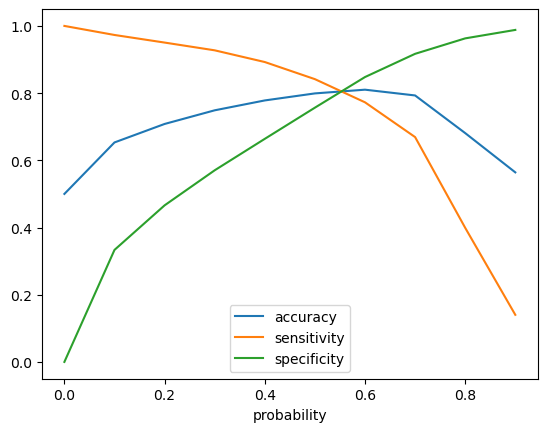

In [106]:
# Plotting accuracy, sensitivity and specificity for different probabilities.
cutoff_df.plot('probability', ['accuracy','sensitivity','specificity'])
plt.show()

We observe that the above curve indicates a good balance in accuracy, sensitivity and specificity is seen at around the probability of 0.6

As per the business problem, the telecom company would benefit by giving more importance to the high probablity of churn, hence considering the cutoff to 0.5

In [107]:
# Creating a column with name "predicted", which is the predicted value for 0.5 cutoff 
y_train_pred_final['predicted'] = y_train_pred_final['churn_prob'].map(lambda x: 1 if x > 0.5 else 0)
y_train_pred_final.head()

,churn,churn_prob,CustID,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,predicted
0,1,0.452767,0,1,1,1,1,1,0,0,0,0,0,0
1,0,0.193597,1,1,1,0,0,0,0,0,0,0,0,0
2,0,0.012362,2,1,0,0,0,0,0,0,0,0,0,0
3,0,0.030849,3,1,0,0,0,0,0,0,0,0,0,0
4,0,0.201612,4,1,1,1,0,0,0,0,0,0,0,0


#### Checking the Metrics

In [108]:
# Confusion metrics
confusion = metrics.confusion_matrix(y_train_pred_final['churn'], y_train_pred_final['predicted'])
print(confusion)

[[14189  4562]
 [ 2970 15781]]


In [109]:

TP = confusion[1,1] # true positive 
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives

In [110]:
# Accuracy
print("Accuracy:-",metrics.accuracy_score(y_train_pred_final['churn'], y_train_pred_final['predicted']))

# Sensitivity
print("Sensitivity:-",TP / float(TP+FN))

# Specificity
print("Specificity:-", TN / float(TN+FP))

Accuracy:- 0.7991573782731588
Sensitivity:- 0.8416084475494641
Specificity:- 0.7567063089968535


In [111]:
# ROC Curve function

def draw_roc( actual, probs ):
    fpr, tpr, thresholds = metrics.roc_curve( actual, probs,
                                              drop_intermediate = False )
    auc_score = metrics.roc_auc_score( actual, probs )
    plt.figure(figsize=(5, 5))
    plt.plot( fpr, tpr, label='ROC curve (area = %0.2f)' % auc_score )
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic example')
    plt.legend(loc="lower right")
    plt.show()

    return None

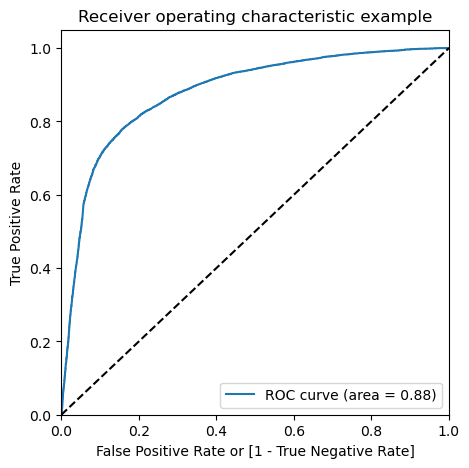

In [112]:

draw_roc(y_train_pred_final['churn'], y_train_pred_final['churn_prob'])

#### Checking on the Test data

In [179]:
# Taking only the columns, which are selected in the train set after removing insignificant and multicollinear variables
X_test_feature_log = X_test_feature[log_cols]


In [180]:
# Adding constant on the test set
X_test_sm = sm.add_constant(X_test_feature_log)

In [181]:
# Predict on the test set
y_test_pred = log_no_pca_4.predict(X_test_sm)

In [182]:
y_test_pred.head()

68391    1.286930e-02
11549    1.819357e-01
15478    3.121722e-08
88690    3.202129e-01
90016    4.567484e-02
dtype: float64

In [183]:
# Converting y_test_pred to a dataframe
y_pred_1 = pd.DataFrame(y_test_pred)
y_pred_1.head()

,0
68391,1.286930e-02
11549,1.819357e-01
15478,3.121722e-08
88690,3.202129e-01
90016,4.567484e-02


In [184]:
# Converting y_test to a dataframe
y_test_df = pd.DataFrame(y_test)
y_test_df.head()

,churn
68391,0
11549,0
15478,0
88690,0
90016,0


In [185]:
# Putting index to Customer ID 
y_test_df['CustID'] = y_test_df.index

In [186]:
# Removing index form the both dataframes for merging them side by side
y_pred_1.reset_index(drop=True, inplace=True)
y_test_df.reset_index(drop=True, inplace=True)

In [188]:
# Appending y_pred_1 and y_test_df
y_test_pred_final = pd.concat([y_test_df, y_pred_1], axis=1)

In [189]:
# Renaming the '0' column as churn probablity
y_test_pred_final = y_test_pred_final.rename(columns={0:'churn_prob'})

In [190]:
y_test_pred_final.head()

,churn,CustID,churn_prob
0,0,68391,1.286930e-02
1,0,11549,1.819357e-01
2,0,15478,3.121722e-08
3,0,88690,3.202129e-01
4,0,90016,4.567484e-02


In [191]:
# In the test set using probablity cutoff 0.5, what we got in the train set 
y_test_pred_final['test_predicted'] = y_test_pred_final['churn_prob'].map(lambda x: 1 if x > 0.5 else 0)

In [192]:
y_test_pred_final.head()

,churn,CustID,churn_prob,test_predicted
0,0,68391,1.286930e-02,0
1,0,11549,1.819357e-01,0
2,0,15478,3.121722e-08,0
3,0,88690,3.202129e-01,0
4,0,90016,4.567484e-02,0


In [193]:
# Confusion matrix
confusion = metrics.confusion_matrix(y_test_pred_final['churn'], y_test_pred_final['test_predicted'])
print(confusion)

[[6075 1961]
 [ 116  420]]


In [194]:
TP = confusion[1,1] # true positive 
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives

In [195]:

# Accuracy
print("Accuracy:",metrics.accuracy_score(y_test_pred_final['churn'], y_test_pred_final['test_predicted']))

# Sensitivity
print("Sensitivity:",TP / float(TP+FN))

# Specificity
print("Specificity:", TN / float(TN+FP))

Accuracy: 0.7576994867008866
Sensitivity: 0.7835820895522388
Specificity: 0.7559731209556994


***Summary:***

**Train:**

Accuracy:- 0.7991573782731588

Sensitivity:- 0.8416084475494641

Specificity:- 0.7567063089968535

**Test:**

Accuracy:- 0.7576994867008866

Sensitivity:- 0.7835820895522388

Specificity:- 0.7559731209556994


#### Summary

Model Performance:

1. Sensitivity takes precedence as business needs to focus on higher probablity of churn 
1. The Logistic Regression with PCA is the best suited model over other models like Decision Tree and Random forest.

### Recommedations for Business.

#### company can focus on below observations to improve business
- incoming local calls decreased in August
- reduced value based cost 3G in September
- reduced total outgoing in August
- increased outgoing t2m minutes of usage in July
- increased  minutes of usage in internet for the month of July
- increased  minutes of usage in local calls for the month of August





